In this notebook, I will demonstrate how to import a csv containing Census Bureau estimates of [components of counties' population change](https://tinyurl.com/k7jvj87), reformat, analyze and join it with a shapefile using Pandas and then visualize and map the data.

In [1]:
import branca.colormap as cm
import folium
import geopandas as gpd
import json
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
# Draw matplotlib visualizations inside the Jupyter notebook
%matplotlib inline
# Set 20 x 10 as the default size for all matplotlib visualizations
plt.rcParams['figure.figsize'] = (20, 10)
import numpy as np
import os
import pandas as pd
# Suppress scientific notation and set the precision of float values to two
pd.set_option('display.float_format', lambda x: '%.2f' % x)
# Display all columns in dataframes
pd.set_option('display.max_columns', None)
import sys

First, import a csv with the population change data.

In [2]:
# Read the second column as a string (object) and skip the first row of column names
change = pd.read_csv('data/population_change.csv', dtype={1: 'object'}, skiprows=1)
change.head(1)

,Id,Id2,Geography,"Cumulative Estimates of the Components of Population Change - April 1, 2010 to July 1, 2016 - Total Population Change [1]","Cumulative Estimates of the Components of Population Change - April 1, 2010 to July 1, 2016 - Natural Increase","Cumulative Estimates of the Components of Population Change - April 1, 2010 to July 1, 2016 - Vital Events - Births","Cumulative Estimates of the Components of Population Change - April 1, 2010 to July 1, 2016 - Vital Events - Deaths","Cumulative Estimates of the Components of Population Change - April 1, 2010 to July 1, 2016 - Net Migration - Total","Cumulative Estimates of the Components of Population Change - April 1, 2010 to July 1, 2016 - Net Migration - International [2]","Cumulative Estimates of the Components of Population Change - April 1, 2010 to July 1, 2016 - Net Migration - Domestic","Annual Estimates of the Components of Population Change - July 1, 2015 to July 1, 2016 - Total Population Change [1]","Annual Estimates of the Components of Population Change - July 1, 2015 to July 1, 2016 - Natural Increase","Annual Estimates of the Components of Population Change - July 1, 2015 to July 1, 2016 - Vital Events - Births","Annual Estimates of the Components of Population Change - July 1, 2015 to July 1, 2016 - Vital Events - Deaths","Annual Estimates of the Components of Population Change - July 1, 2015 to July 1, 2016 - Net Migration - Total","Annual Estimates of the Components of Population Change - July 1, 2015 to July 1, 2016 - Net Migration - International [2]","Annual Estimates of the Components of Population Change - July 1, 2015 to July 1, 2016 - Net Migration - Domestic"
0,0500000US01001,01001,"Autauga County, Alabama",845,535,3882,3347,176,76,100,381,137,631,494,235,7,228


Some of those column names are way too long. Let's shorten them.

In [3]:
# Create a list containing the new column names
change_cols = ['id', 'id2', 'geography', 'change_1016_total', 'change_1016_natural', 'change_1016_births', 'change_1016_deaths', 'change_1016_migration', 'change_1016_international', 'change_1016_domestic', 'change_1516_total', 'change_1516_natural', 'change_1516_births', 'change_1516_deaths', 'change_1516_migration', 'change_1516_international', 'change_1516_domestic' ]
# Set the dataframe's columns equal to the list of new column names
change.columns = change_cols
change.head(1)

,id,id2,geography,change_1016_total,change_1016_natural,change_1016_births,change_1016_deaths,change_1016_migration,change_1016_international,change_1016_domestic,change_1516_total,change_1516_natural,change_1516_births,change_1516_deaths,change_1516_migration,change_1516_international,change_1516_domestic
0,0500000US01001,01001,"Autauga County, Alabama",845,535,3882,3347,176,76,100,381,137,631,494,235,7,228


OK. And we're really just interested in comparing 2015 to 2016 so let's get rid of the 2010 to 2016 data.

In [4]:
change_1516 = change[change.columns[[0, 1, 2, 10, 11, 12, 13, 14, 15, 16]]] # Create a new dataframe containing only the 15-16 data
change_1516.head(1)

,id,id2,geography,change_1516_total,change_1516_natural,change_1516_births,change_1516_deaths,change_1516_migration,change_1516_international,change_1516_domestic
0,0500000US01001,01001,"Autauga County, Alabama",381,137,631,494,235,7,228


Now. Time for some analysis!  
What counties saw the greatest population growth?

In [5]:
change_1516.sort_values('change_1516_total', ascending=False).head()

,id,id2,geography,change_1516_total,change_1516_natural,change_1516_births,change_1516_deaths,change_1516_migration,change_1516_international,change_1516_domestic
103,0500000US04013,04013,"Maricopa County, Arizona",81360,25428,56073,30645,53377,10188,43189
2623,0500000US48201,48201,"Harris County, Texas",56587,46412,73072,26660,11697,27922,-16225
1748,0500000US32003,32003,"Clark County, Nevada",46375,10851,27352,16501,34301,6566,27735
2969,0500000US53033,53033,"King County, Washington",35714,12325,25905,13580,24011,15500,8511
2742,0500000US48439,48439,"Tarrant County, Texas",35462,15779,28682,12903,19759,6348,13411


And which saw the greatest population decline?

In [6]:
change_1516.sort_values('change_1516_total', ascending=True).head()

,id,id2,geography,change_1516_total,change_1516_natural,change_1516_births,change_1516_deaths,change_1516_migration,change_1516_international,change_1516_domestic
610,0500000US17031,17031,"Cook County, Illinois",-21324,25752,68049,42297,-47810,18434,-66244
1312,0500000US26163,26163,"Wayne County, Michigan",-7696,4978,23209,18231,-13067,4279,-17346
1216,0500000US24510,24510,"Baltimore city, Maryland",-6738,1783,8654,6871,-8813,2195,-11008
2060,0500000US39035,39035,"Cuyahoga County, Ohio",-5673,1378,14941,13563,-6720,3402,-10122
1879,0500000US36103,36103,"Suffolk County, New York",-5320,2653,15446,12793,-6951,4327,-11278


The raw population change is telling but getting that figure as the percent change between each county's 2015 and 2016 populations will make it easier to compare counties to one another.  
  
First, we need to import a csv with 2015 and 2016 population data.

In [7]:
# Read the second column as a string (object) and skip the first row of column names
pops = pd.read_csv('data/population.csv', dtype={1: 'object'}, skiprows=1)
pops.head(1)

,Id,Id2,Geography,"April 1, 2010 - Census","April 1, 2010 - Estimates Base",Population Estimate (as of July 1) - 2010,Population Estimate (as of July 1) - 2011,Population Estimate (as of July 1) - 2012,Population Estimate (as of July 1) - 2013,Population Estimate (as of July 1) - 2014,Population Estimate (as of July 1) - 2015,Population Estimate (as of July 1) - 2016
0,0500000US01001,01001,"Autauga County, Alabama",54571,54571,54742,55255,55027,54792,54977,55035,55416


Again, some of those column names are way too long. So we'll shorten them.

In [8]:
# Create a list containing the new column names
pops_cols = ['id', 'id2', 'geography', 'pop_census', 'pop_census_base', 'pop_10', 'pop_11', 'pop_12', 'pop_13', 'pop_14', 'pop_15', 'pop_16']
# Set the dataframe's columns equal to the list of new column names
pops.columns = pops_cols
pops.head(1)

,id,id2,geography,pop_census,pop_census_base,pop_10,pop_11,pop_12,pop_13,pop_14,pop_15,pop_16
0,0500000US01001,01001,"Autauga County, Alabama",54571,54571,54742,55255,55027,54792,54977,55035,55416


Awesome. And just like with the population change data, let's create a new dataframe that only contains the 2015 and 2016 numbers.

In [9]:
pops_1516 = pops[pops.columns[[0, 1, 2, 10, 11]]] # Create a new dataframe containing only the 15-16 data
pops_1516.head(1)

,id,id2,geography,pop_15,pop_16
0,0500000US01001,01001,"Autauga County, Alabama",55035,55416


Now we need to merge the dataframe containing the population data with the dataframe containing the population change data.

In [10]:
pops_change_1516 = pops_1516.merge(change_1516, on='id2')
pops_change_1516.shape # All 3,142 records matched

(3142, 14)

In [11]:
pops_change_1516.head(1)

,id_x,id2,geography_x,pop_15,pop_16,id_y,geography_y,change_1516_total,change_1516_natural,change_1516_births,change_1516_deaths,change_1516_migration,change_1516_international,change_1516_domestic
0,0500000US01001,01001,"Autauga County, Alabama",55035,55416,0500000US01001,"Autauga County, Alabama",381,137,631,494,235,7,228


As both data frames had id and geography columns, those columns now appear twice in the new data frame. Let's delete the duplicates and rename the remaining ones.

In [12]:
pops_change_1516.drop(['id_y', 'geography_y'], axis=1, inplace=True)
pops_change_1516.rename(columns = {'id_x': 'id', 'geography_x': 'geography'}, inplace=True)
pops_change_1516.head(1)

,id,id2,geography,pop_15,pop_16,change_1516_total,change_1516_natural,change_1516_births,change_1516_deaths,change_1516_migration,change_1516_international,change_1516_domestic
0,0500000US01001,01001,"Autauga County, Alabama",55035,55416,381,137,631,494,235,7,228


Perfect. Now that we've got our numbers all in one place, we can finally calculate percent change figures.

In [13]:
pops_change_1516['change_1516_total_pct'] = pops_change_1516.change_1516_total / pops_change_1516.pop_15
pops_change_1516['change_1516_natural_pct'] = pops_change_1516.change_1516_natural / pops_change_1516.pop_15
pops_change_1516['change_1516_migration_pct'] = pops_change_1516.change_1516_migration / pops_change_1516.pop_15
pops_change_1516.head(1)

,id,id2,geography,pop_15,pop_16,change_1516_total,change_1516_natural,change_1516_births,change_1516_deaths,change_1516_migration,change_1516_international,change_1516_domestic,change_1516_total_pct,change_1516_natural_pct,change_1516_migration_pct
0,0500000US01001,01001,"Autauga County, Alabama",55035,55416,381,137,631,494,235,7,228,0.01,0.00,0.00


I don't like that the percent change columns are all bunched up at the end of the dataframe. Let's move them so each percent change column stands next to its numerical equivalent (and let's also switch the pop_15 and pop_16 columns while we're at it).

In [14]:
# Create a list containing the column names
pops_change_1516_cols = pops_change_1516.columns.tolist()
# Reorder the columns
pops_change_1516_cols = pops_change_1516_cols[:3] + [pops_change_1516_cols[4]] + [pops_change_1516_cols[3]] + [pops_change_1516_cols[5]] + [pops_change_1516_cols[-3]] + [pops_change_1516_cols[6]] + [pops_change_1516_cols[-2]] + pops_change_1516_cols[7:9] + [pops_change_1516_cols[9]] + [pops_change_1516_cols[-1]] + pops_change_1516_cols[10:12]
# Set the dataframe's columns equal to the list of reordered column names
pops_change_1516 = pops_change_1516[pops_change_1516_cols]
pops_change_1516.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3142 entries, 0 to 3141
Data columns (total 15 columns):
id                           3142 non-null object
id2                          3142 non-null object
geography                    3142 non-null object
pop_16                       3142 non-null int64
pop_15                       3142 non-null int64
change_1516_total            3142 non-null int64
change_1516_total_pct        3142 non-null float64
change_1516_natural          3142 non-null int64
change_1516_natural_pct      3142 non-null float64
change_1516_births           3142 non-null int64
change_1516_deaths           3142 non-null int64
change_1516_migration        3142 non-null int64
change_1516_migration_pct    3142 non-null float64
change_1516_international    3142 non-null int64
change_1516_domestic         3142 non-null int64
dtypes: float64(3), int64(9), object(3)
memory usage: 392.8+ KB


Now let's do some analysis.  
  
To start, which counties saw the greatest positive percent change in population?

In [15]:
pops_change_1516.sort_values('change_1516_total_pct', ascending=False).head()

,id,id2,geography,pop_16,pop_15,change_1516_total,change_1516_total_pct,change_1516_natural,change_1516_natural_pct,change_1516_births,change_1516_deaths,change_1516_migration,change_1516_migration_pct,change_1516_international,change_1516_domestic
2637,0500000US48229,48229,"Hudspeth County, Texas",4053,3425,628,0.18,37,0.01,46,9,590,0.17,17,573
2795,0500000US49037,49037,"San Juan County, Utah",16895,15707,1188,0.08,128,0.01,240,112,1051,0.07,13,1038
2652,0500000US48259,48259,"Kendall County, Texas",42540,40452,2088,0.05,2,0.00,391,389,1921,0.05,77,1844
2627,0500000US48209,48209,"Hays County, Texas",204470,194574,9896,0.05,1542,0.01,2553,1011,8103,0.04,171,7932
2802,0500000US49051,49051,"Wasatch County, Utah",30528,29165,1363,0.05,349,0.01,475,126,968,0.03,77,891


And which counties saw the greatest negative percent change?

In [16]:
pops_change_1516.sort_values('change_1516_total_pct', ascending=True).head()

,id,id2,geography,pop_16,pop_15,change_1516_total,change_1516_total_pct,change_1516_natural,change_1516_natural_pct,change_1516_births,change_1516_deaths,change_1516_migration,change_1516_migration_pct,change_1516_international,change_1516_domestic
1752,0500000US32011,32011,"Eureka County, Nevada",1917,2027,-110,-0.05,10,0.00,18,8,-133,-0.07,0,-133
2744,0500000US48443,48443,"Terrell County, Texas",812,855,-43,-0.05,-2,-0.00,10,12,-41,-0.05,2,-43
1996,0500000US38013,38013,"Burke County, North Dakota",2198,2312,-114,-0.05,20,0.01,41,21,-140,-0.06,-1,-139
1806,0500000US35021,35021,"Harding County, New Mexico",665,699,-34,-0.05,-1,-0.00,6,7,-35,-0.05,0,-35
952,0500000US20129,20129,"Morton County, Kansas",2848,2992,-144,-0.05,9,0.00,38,29,-153,-0.05,-2,-151


Now, let's visualize the data set! There are lots of ways to do this, one of which is a histogram where we plot each of the three percent change columns.

([array([  0.00000000e+00,   7.00000000e+00,   1.10000000e+01,
           4.00000000e+01,   1.28000000e+02,   6.31000000e+02,
           1.23000000e+03,   6.92000000e+02,   2.72000000e+02,
           8.90000000e+01,   3.40000000e+01,   6.00000000e+00,
           0.00000000e+00,   0.00000000e+00,   1.00000000e+00,
           0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
           0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
           0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
           1.00000000e+00]),
  array([  0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
           0.00000000e+00,   0.00000000e+00,   8.90000000e+01,
           2.36800000e+03,   6.64000000e+02,   2.00000000e+01,
           1.00000000e+00,   0.00000000e+00,   0.00000000e+00,
           0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
           0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
           0.00000000e+00,   0.00000000e+00,   0.00000000e+00,
           0.00000000e+00,

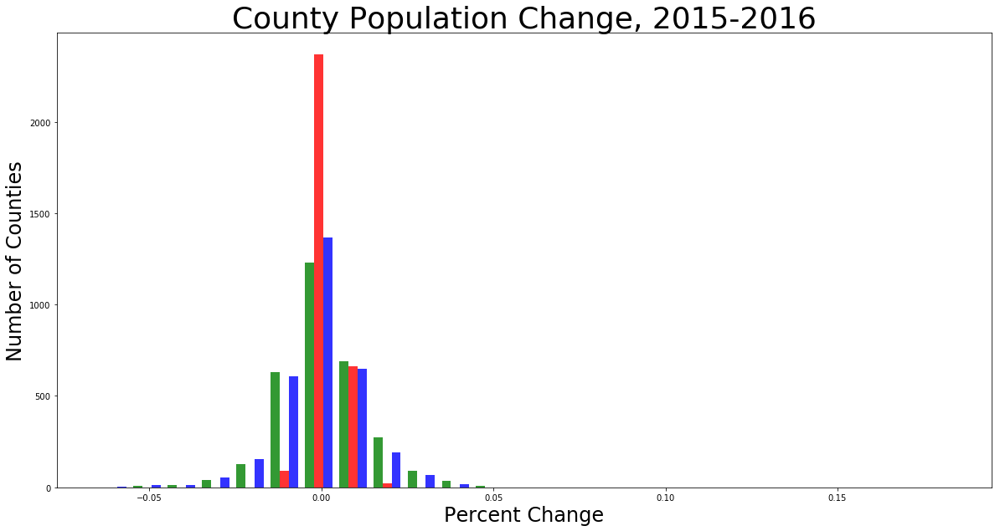

In [17]:
# Define variables for each of the three change components columns
total = pops_change_1516['change_1516_total_pct']
natural = pops_change_1516['change_1516_natural_pct']
migration = pops_change_1516['change_1516_migration_pct']
plt.title('County Population Change, 2015-2016', size=36)
plt.xlabel('Percent Change', size=24)
plt.ylabel('Number of Counties', size=24)
# Plot the columns, assigning a different color to each and specifying the number of bins into which the data will be split
plt.hist([total, natural, migration], color=['green','red','blue'], alpha=0.8, bins=25)

Hmm...OK, so maybe not the most enlightening visualization since so many of the counties are bunched up right around zero percent change. Let's see what the data looks like mapped.  
  
The first step in preparing this data for mapping is to bin some of the columns to create categorical data suitable for quickly visualizing whether a county's population increased or decreased.

In [18]:
# Define binning variables for each of the three change components columns
change_1516_total_bins = [min(pops_change_1516.change_1516_total) - 1, 0, max(pops_change_1516.change_1516_total)]
change_1516_natural_bins = [min(pops_change_1516.change_1516_natural) -1 , 0, max(pops_change_1516.change_1516_natural)]
change_1516_migration_bins = [min(pops_change_1516.change_1516_migration) - 1, 0, max(pops_change_1516.change_1516_migration)]

# Define a names variable for the groups
group_names = ['Decrease', 'Increase']

In [19]:
# Create the new categorical columns and add them to the dataframe
pops_change_1516['change_1516_total_category'] = pd.cut(pops_change_1516['change_1516_total'], change_1516_total_bins, labels=group_names)
pops_change_1516['change_1516_natural_category'] = pd.cut(pops_change_1516['change_1516_natural'], change_1516_natural_bins, labels=group_names)
pops_change_1516['change_1516_migration_category'] = pd.cut(pops_change_1516['change_1516_migration'], change_1516_migration_bins, labels=group_names)
pops_change_1516.head(1)

,id,id2,geography,pop_16,pop_15,change_1516_total,change_1516_total_pct,change_1516_natural,change_1516_natural_pct,change_1516_births,change_1516_deaths,change_1516_migration,change_1516_migration_pct,change_1516_international,change_1516_domestic,change_1516_total_category,change_1516_natural_category,change_1516_migration_category
0,0500000US01001,01001,"Autauga County, Alabama",55416,55035,381,0.01,137,0.00,631,494,235,0.00,7,228,Increase,Increase,Increase


As with the percent change columns, I don't like that the categorical columns are all bunched up at the end of the dataframe. Let's move them so each categorical column stands next to its numerical and percent change equivalents.

In [20]:
# Create a list containing the column names
pops_change_1516_cols = pops_change_1516.columns.tolist()
# Reorder the columns
pops_change_1516_cols = pops_change_1516_cols[:5] + [pops_change_1516_cols[-3]] + pops_change_1516_cols[5:7] + [pops_change_1516_cols[-2]] + pops_change_1516_cols[7:11] + [pops_change_1516_cols[-1]] + pops_change_1516_cols[11:15]
# Set the dataframe's columns equal to the list of reordered column names
pops_change_1516 = pops_change_1516[pops_change_1516_cols]
pops_change_1516.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3142 entries, 0 to 3141
Data columns (total 18 columns):
id                                3142 non-null object
id2                               3142 non-null object
geography                         3142 non-null object
pop_16                            3142 non-null int64
pop_15                            3142 non-null int64
change_1516_total_category        3142 non-null category
change_1516_total                 3142 non-null int64
change_1516_total_pct             3142 non-null float64
change_1516_natural_category      3142 non-null category
change_1516_natural               3142 non-null int64
change_1516_natural_pct           3142 non-null float64
change_1516_births                3142 non-null int64
change_1516_deaths                3142 non-null int64
change_1516_migration_category    3142 non-null category
change_1516_migration             3142 non-null int64
change_1516_migration_pct         3142 non-null float64
change_1516

All right. The columns have been successfully reordered. But notice their data type is "category." We need to change that to object (string) so Python won't throw an error when we later attempt to export the dataframe as a GIS file.

In [21]:
pops_change_1516['change_1516_total_category'] = pops_change_1516.change_1516_total_category.astype(object)
pops_change_1516['change_1516_natural_category'] = pops_change_1516.change_1516_natural_category.astype(object)
pops_change_1516['change_1516_migration_category'] = pops_change_1516.change_1516_migration_category.astype(object)
pops_change_1516.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3142 entries, 0 to 3141
Data columns (total 18 columns):
id                                3142 non-null object
id2                               3142 non-null object
geography                         3142 non-null object
pop_16                            3142 non-null int64
pop_15                            3142 non-null int64
change_1516_total_category        3142 non-null object
change_1516_total                 3142 non-null int64
change_1516_total_pct             3142 non-null float64
change_1516_natural_category      3142 non-null object
change_1516_natural               3142 non-null int64
change_1516_natural_pct           3142 non-null float64
change_1516_births                3142 non-null int64
change_1516_deaths                3142 non-null int64
change_1516_migration_category    3142 non-null object
change_1516_migration             3142 non-null int64
change_1516_migration_pct         3142 non-null float64
change_1516_inter

Now that we've prepared the population data for mapping, we need to import a shapefile of US counties that contains the GIS data that we will use to actually plot the counties on a map.

In [22]:
shapes = gpd.read_file('data/us_counties/us_counties.shp')
shapes.head(1)

,ALAND,AWATER,CBSAFP,CLASSFP,COUNTYFP,COUNTYNS,CSAFP,FUNCSTAT,GEOID,INTPTLAT,INTPTLON,LSAD,METDIVFP,MTFCC,NAME,NAMELSAD,STATEFP,geometry
0,1477895811,10447360,None,H1,039,00835841,None,A,31039,+41.9158651,-096.7885168,06,None,G4020,Cuming,Cuming County,31,"POLYGON ((-97.019516 42.004097, -97.019519 42...."


I hate uppercase column names. Let's make them lowercase.

In [23]:
shapes.columns = shapes.columns.str.lower()
shapes.head(1)

,aland,awater,cbsafp,classfp,countyfp,countyns,csafp,funcstat,geoid,intptlat,intptlon,lsad,metdivfp,mtfcc,name,namelsad,statefp,geometry
0,1477895811,10447360,None,H1,039,00835841,None,A,31039,+41.9158651,-096.7885168,06,None,G4020,Cuming,Cuming County,31,"POLYGON ((-97.019516 42.004097, -97.019519 42...."


Now we need to merge the dataframe containing the geographic data with the dataframe containing the population data.

In [24]:
counties = shapes.merge(pops_change_1516, left_on='geoid', right_on='id2')
counties.shape # All 3,142 records matched

(3142, 36)

In [25]:
counties.head(1)

,aland,awater,cbsafp,classfp,countyfp,countyns,csafp,funcstat,geoid,intptlat,intptlon,lsad,metdivfp,mtfcc,name,namelsad,statefp,geometry,id,id2,geography,pop_16,pop_15,change_1516_total_category,change_1516_total,change_1516_total_pct,change_1516_natural_category,change_1516_natural,change_1516_natural_pct,change_1516_births,change_1516_deaths,change_1516_migration_category,change_1516_migration,change_1516_migration_pct,change_1516_international,change_1516_domestic
0,1477895811,10447360,None,H1,039,00835841,None,A,31039,+41.9158651,-096.7885168,06,None,G4020,Cuming,Cuming County,31,"POLYGON ((-97.019516 42.004097, -97.019519 42....",0500000US31039,31039,"Cuming County, Nebraska",9016,9130,Decrease,-114,-0.01,Increase,40,0.00,126,86,Decrease,-159,-0.02,18,-177


And now...let's map!

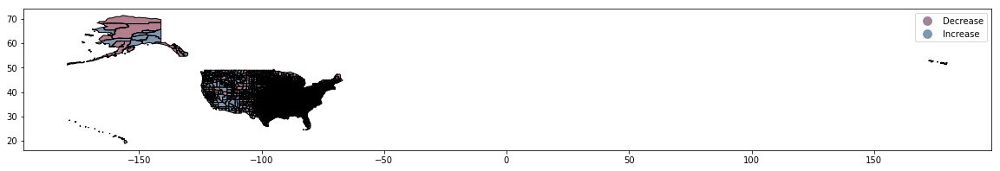

In [26]:
counties.plot(column='change_1516_total_category', categorical=True, cmap='RdBu', legend=True);

Hmm...Alaska and Hawaii are stretching out the map. Curse our imperial pretensions! Let's cut them loose.

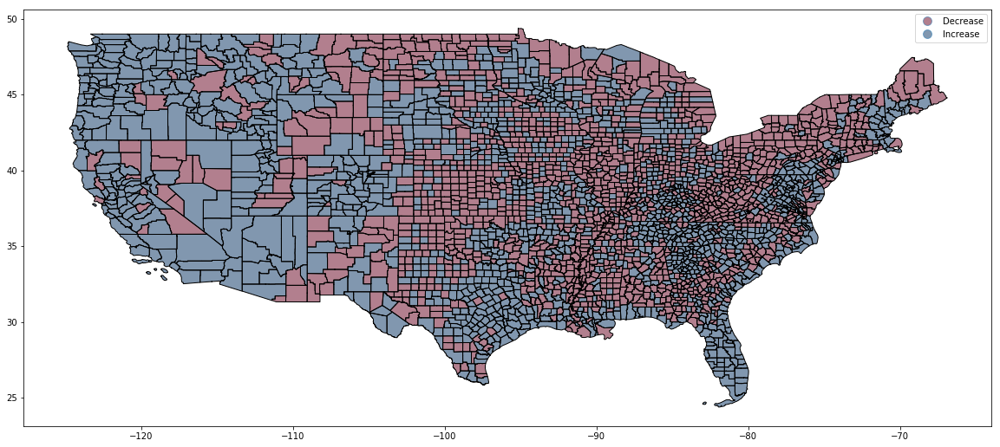

In [27]:
continental = counties[(~counties.geography.str.contains(', Alaska')) & (~counties.geography.str.contains(', Hawaii'))]
continental.plot(column='change_1516_total_category', categorical=True, cmap='RdBu', legend=True);

Which counties had more births than deaths and vice versa?

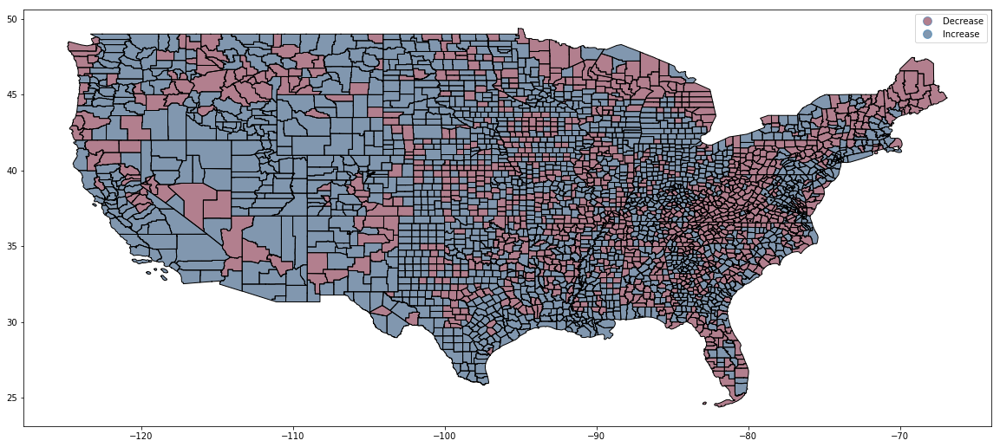

In [28]:
continental.plot(column='change_1516_natural_category', categorical=True, cmap='RdBu', legend=True);

Which counties had net positive and which net negative migration patterns?

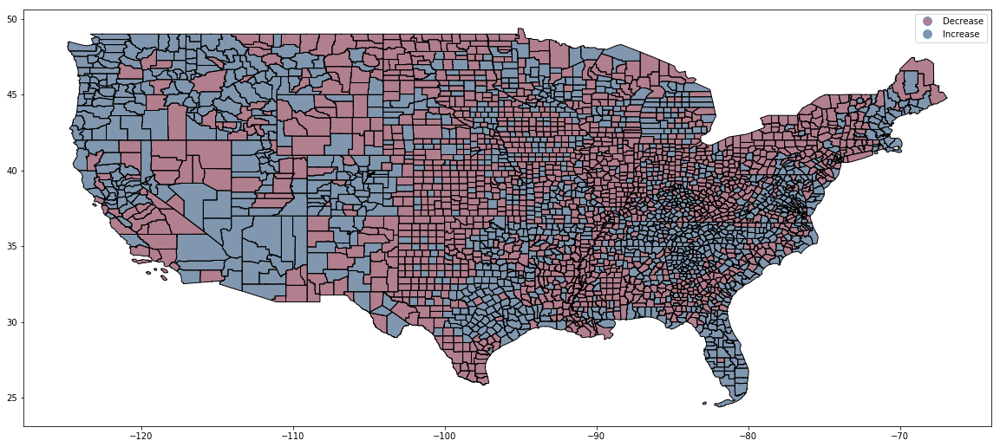

In [29]:
continental.plot(column='change_1516_migration_category', categorical=True, cmap='RdBu', legend=True);

These maps are OK but they're still too big to see what's going on at the county level. Let's just focus on New England.

In [30]:
new_england = counties[(counties.geography.str.contains(', Connecticut')) | (counties.geography.str.contains(', Maine')) | (counties.geography.str.contains(', Massachusetts')) | (counties.geography.str.contains(', New Hampshire')) | (counties.geography.str.contains(', Rhode Island')) | (counties.geography.str.contains(', Vermont'))] 
new_england.shape # 67 counties returned, as expected

(67, 36)

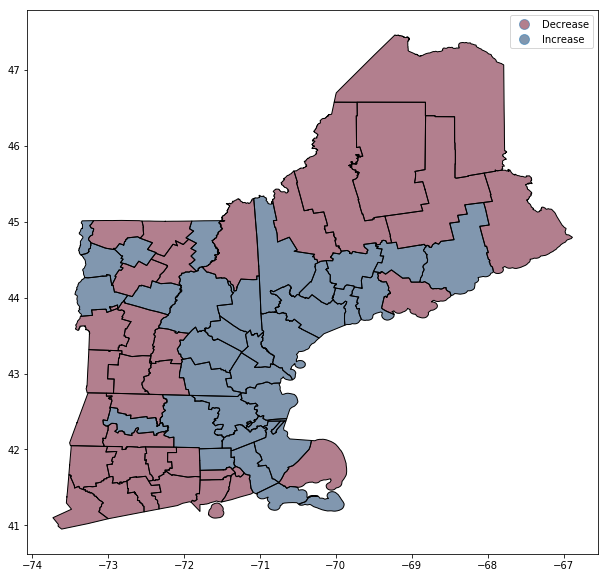

In [31]:
new_england.plot(column='change_1516_total_category', cmap='RdBu', legend=True);

Much clearer. Now, let's try mapping the percent change by different categories using Folium, a mapping package based on the popular Leaflet mapping library. Folium maps have the added capabilities of panning and zooming.  
  
The first thing we'll need to do is export our New England dataframe as a geojson file.

In [32]:
# Export the new_england dataframe as a geojson file (the file type required for Folium maps)
new_england.to_file('data/new_england.geojson', driver='GeoJSON')

In [33]:
# Set a variable equal to the newly created geojson file
new_england_geo = r'data/new_england.geojson'
# Create a new dataframe to hold the geojson file's data
new_england_data = gpd.read_file('data/new_england.geojson')

Now that we've got our variables ready, it's time to make some maps.  
  
Let's start by mapping the total change in population.

In [34]:
total_map = folium.Map(location=[44.40, -70.99], zoom_start=6)
total_map.choropleth(geo_path=new_england_geo,
                          data_out='data.json',
                          data=new_england_data,
                          columns=['geoid', 'change_1516_total_pct'],
                          key_on='feature.properties.geoid',
                          fill_color='RdBu',
                          fill_opacity=0.7,
                          line_opacity=0.3,
                          legend_name='Total 2015-2016 Population Change',
                          highlight=True)
# Call the map
total_map

Overall, the populations of New England counties seem to be staying fairly stable, especially closer to the coast. In order to tease out why that is, we need to map by the components of population change: natural increase or decrease and immigration or emigration.
  
So, let's map the population change from births and deaths first.

In [35]:
natural_map = folium.Map(location=[44.40, -70.99], zoom_start=6)
natural_map.choropleth(geo_path=new_england_geo,
                          data_out='data.json',
                          data=new_england_data,
                          columns=['geoid', 'change_1516_natural_pct'],
                          key_on='feature.properties.geoid',
                          fill_color='RdBu',
                          fill_opacity=0.7,
                          line_opacity=0.3,
                          legend_name='2015-2016 Population Change from Births and Deaths',
                          highlight=True)
# Call the map
natural_map

Now things are becomining a bit clearer, aren't they? The residents of most New England counties aren't reproducing enough to maintain the population. That means there must be a fair amount of immigration to these counties to keep the total population from decreasing significantly. Let's map the population change due to migration to be sure.

In [36]:
migration_map = folium.Map(location=[44.40, -70.99], zoom_start=6)
migration_map.choropleth(geo_path=new_england_geo,
                          data_out='data.json',
                          data=new_england_data,
                          columns=['geoid', 'change_1516_migration_pct'],
                          key_on='feature.properties.geoid',
                          fill_color='RdBu',
                          fill_opacity=0.7,
                          line_opacity=0.3,
                          legend_name='2015-2016 Population Change due to Migration',
                          highlight=True)
# Call the map
migration_map

And sure enough, most New England counties saw positive net migration. Again, this is particularly true for counties in coastal New England.

Lastly, let's export these maps as html files for further styling and eventually embedding on our website.

In [37]:
total_map.save('total.html')
natural_map.save('natural.html')
migration_map.save('migration.html')